In [4]:
# Importing Required Libraries
import os
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import h5py
from PIL import Image
import cv2
from torchvision import transforms
import albumentations as A
from glob import glob


In [2]:
base_directory = os.path.join(os.getcwd(), "typhon_images", "image")

h5_file_paths = []

# Target size for resizing
# desired_size = (256, 256)
desired_size = (300, 300)

# collecting the .h5 files 197902
for i in range(1, 481):
    target_path = os.path.join(base_directory, str(i))
    FILE_PATH = Path(target_path)          # converting the target path into a path object
    for file in FILE_PATH.glob("*.h5"):
        h5_file_paths.append(file)

print(h5_file_paths)

# opening and inspecting each image file
for path in h5_file_paths:
    with h5py.File(path, "r") as f:
        print(f"File: {path.name}")
        print("Keys in file:", list(f.keys()))
        infrared_data = f['Infrared']
        print(type(infrared_data))

        #  checking shape and dtype of the dataset
        if isinstance(infrared_data, h5py.Dataset):
            print("Shape:", infrared_data.shape)
            print("Data type:", infrared_data.dtype)

            data = infrared_data[:]
            # print(data)

    # OpenCV resizing (note: cv2 expects shape as (width, height))
    # First normalize to 0–255 for resizing if dtype is float
    data_min = np.min(data)
    data_max = np.max(data)
    data_scaled = 255 * (data - data_min) / (data_max - data_min)
    data_scaled = data_scaled.astype(np.uint8)

    # Resize using cv2 (height, width order)
    # resized_array = cv2.resize(data_scaled, desired_size, interpolation=cv2.INTER_AREA)
    resized_array = cv2.resize(data_scaled, desired_size, interpolation=cv2.INTER_CUBIC)
    # Convert back to float normalized 0–1
    normalized = resized_array.astype(np.float32) / 255.0

    
    # # Convert array to PIL image and resize
    # image_pil = Image.fromarray(data)
    # image_resized = image_pil.resize(desired_size, resample=Image.BILINEAR)
    # resized_array = np.array(image_resized)

    # # NORMALIZATION
    # # Using Min-MAx Normalization
    # data_min = np.min(resized_array)
    # data_max = np.max(resized_array)
    # normalized = (resized_array - data_min) / (data_max - data_min)

    #  Directory for the normalized level
    normalized_output_dir = os.path.join(os.getcwd(), "typhon_images", "processed", "normalized")
    os.makedirs(normalized_output_dir, exist_ok = True)
    # print(f"Saving normalized images to: {normalized_output_dir}")

    # Creating filename for saving the images
    filename = os.path.splitext(path.name)[0] + "_normalized.npy"
    normalized_img_path = os.path.join(normalized_output_dir, filename)

    # Saving the file
    np.save(normalized_img_path, normalized)



[WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978122906-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978122909-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978122912-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978122916-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978122918-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978122921-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978123000-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978123003-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978123006-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/image/1/1978123009-197901-GMS1-1.h5'), WindowsPath('d:/Sneha/DA/DL_ntcc_project/typhon_images/imag

C:\Users\Aastha\AppData\Local\Temp\ipykernel_11160\3911976103.py:38: RuntimeWarning: invalid value encountered in divide
  data_scaled = 255 * (data - data_min) / (data_max - data_min)
C:\Users\Aastha\AppData\Local\Temp\ipykernel_11160\3911976103.py:39: RuntimeWarning: invalid value encountered in cast
  data_scaled = data_scaled.astype(np.uint8)


File: 1989121303-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121304-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121305-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121306-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121307-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121308-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121309-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class 'h5py._hl.dataset.Dataset'>
Shape: (512, 512)
Data type: float64
File: 1989121310-199002-GMS4-1.h5
Keys in file: ['Infrared']
<class '

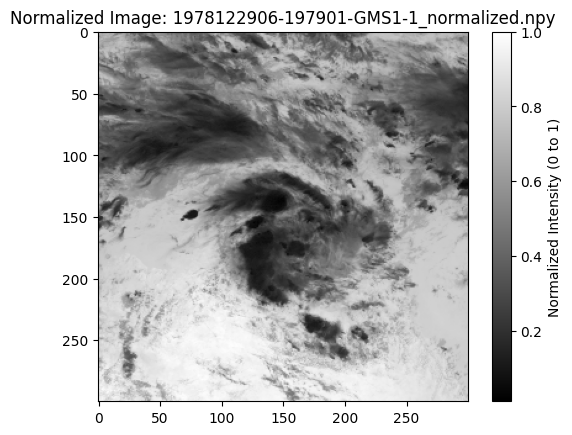

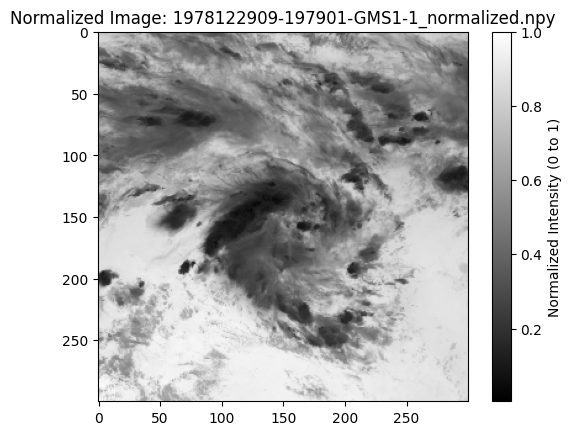

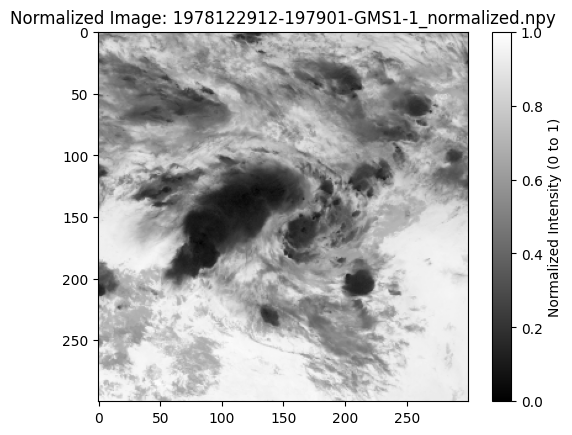

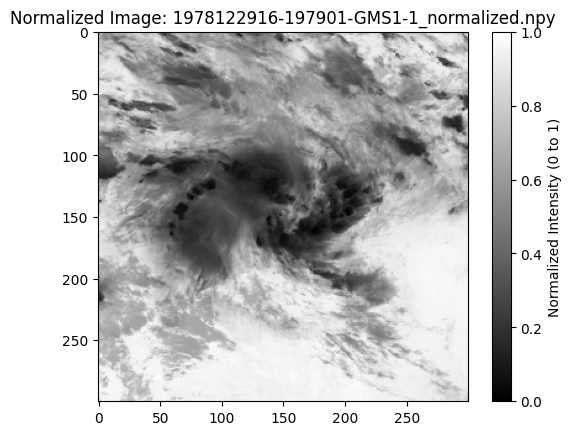

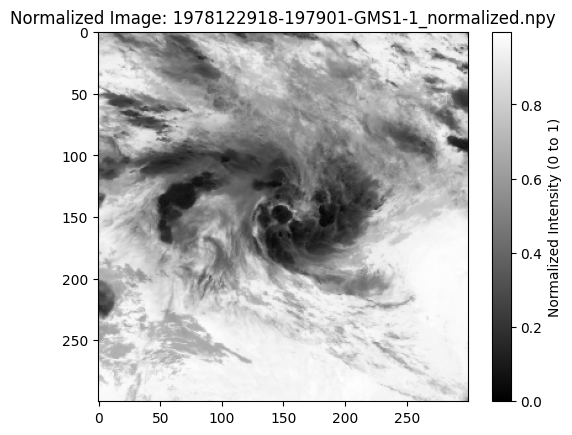

...

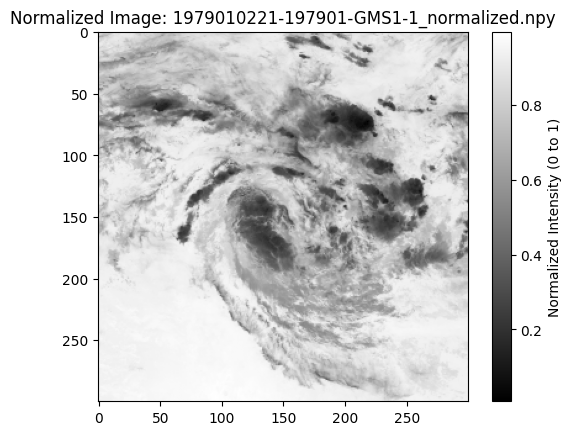

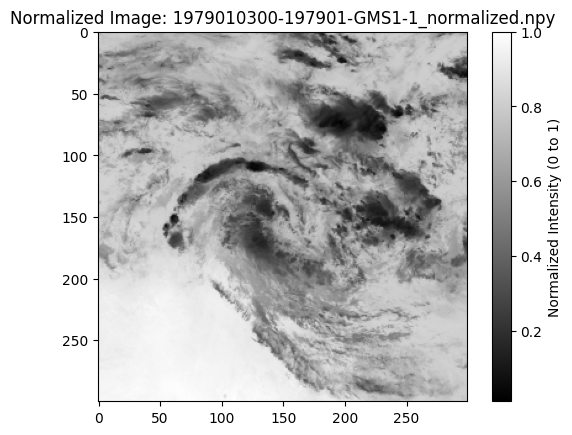

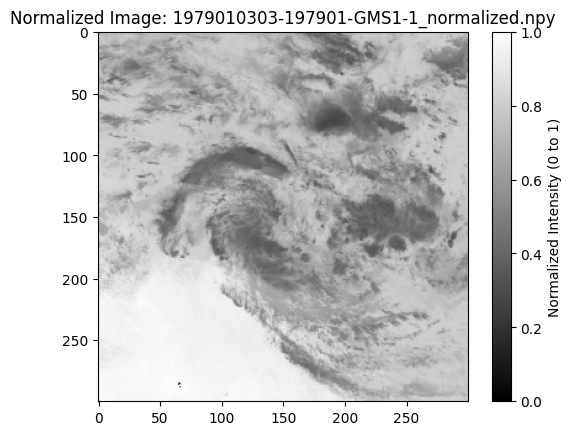

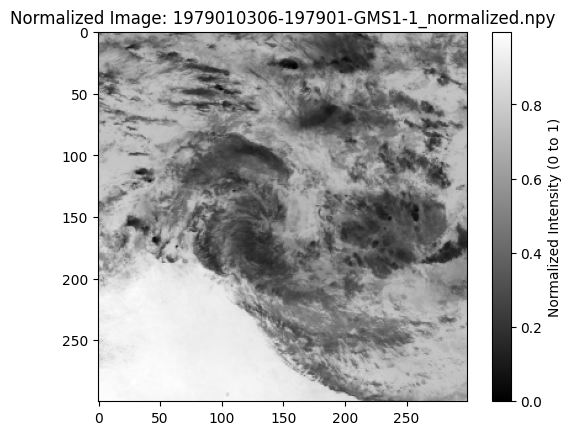

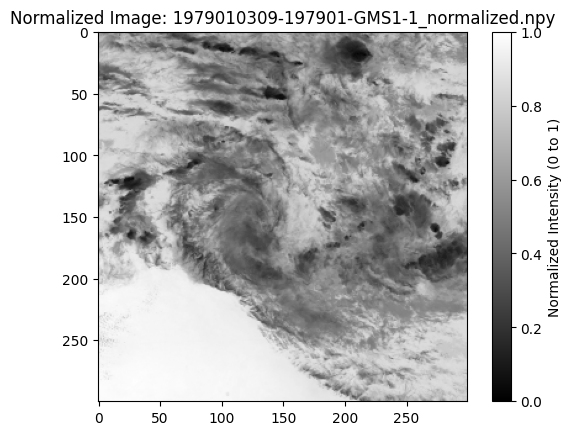

In [ ]:
# Path to directory with normalized .npy files
npy_file_path = os.path.join(os.getcwd(), "typhon_images", "processed", "normalized")
npy_file = Path(npy_file_path)

# Loop through each .npy file and display it
for file in npy_file.glob("*.npy"):
    image = np.load(file)  # Load the actual array from the .npy file

    plt.imshow(image, cmap='gray')  # Note: correct spelling is 'gray'
    plt.colorbar(label="Normalized Intensity (0 to 1)")
    plt.title(f"Normalized Image: {file.name}")
    plt.show()

### Data Labeling

In [3]:
# Converting npy images to png files

def convert_npy_to_png(npy_dir, png_output_dir):
    """This function convert the images into png format from the numpy array"""
    os.makedirs(png_output_dir, exist_ok=True)
    for file in os.listdir(npy_dir):
        if file.endswith('.npy'):
            npy_path = os.path.join(npy_dir, file)
            arr = np.load(npy_path)  # normalized image (0 to 1)
            arr = (arr * 255).astype(np.uint8)  # convert to 0-255 for PNG
            img = Image.fromarray(arr)
            output_filename = file.replace('.npy', '.png')
            img.save(os.path.join(png_output_dir, output_filename))
            print(f"Saved: {output_filename}")

# Example usage:
npy_file_path = os.path.join(os.getcwd(), "typhon_images", "processed", "normalized")
npy_file = Path(npy_file_path)

png_output = os.path.join(os.getcwd(), "label_images_png")
png_output_dir = Path(png_output)

convert_npy_to_png(npy_dir=npy_file, png_output_dir=png_output_dir)



Saved: 1978122906-197901-GMS1-1_normalized.png
Saved: 1978122909-197901-GMS1-1_normalized.png
Saved: 1978122912-197901-GMS1-1_normalized.png
Saved: 1978122916-197901-GMS1-1_normalized.png
Saved: 1978122918-197901-GMS1-1_normalized.png
Saved: 1978122921-197901-GMS1-1_normalized.png
Saved: 1978123000-197901-GMS1-1_normalized.png
Saved: 1978123003-197901-GMS1-1_normalized.png
Saved: 1978123006-197901-GMS1-1_normalized.png
Saved: 1978123009-197901-GMS1-1_normalized.png
Saved: 1978123012-197901-GMS1-1_normalized.png
Saved: 1978123016-197901-GMS1-1_normalized.png
Saved: 1978123018-197901-GMS1-1_normalized.png
Saved: 1978123021-197901-GMS1-1_normalized.png
Saved: 1978123100-197901-GMS1-1_normalized.png
Saved: 1978123103-197901-GMS1-1_normalized.png
Saved: 1978123106-197901-GMS1-1_normalized.png
Saved: 1978123109-197901-GMS1-1_normalized.png
Saved: 1978123112-197901-GMS1-1_normalized.png
Saved: 1978123116-197901-GMS1-1_normalized.png
Saved: 1978123118-197901-GMS1-1_normalized.png
Saved: 197812

### **Data Labelling**

### **Data Augmentation**

In [ ]:

from PIL import Image

transform = transforms.Compose([
    transforms.RandomRotation(15),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomResizedCrop(300, scale=(0.9, 1.1)),
    transforms.ToTensor()
])

# Example usage
img = Image.open('path_to_image.jpg')
augmented_img = transform(img)


In [ ]:
# Augmentation pipeline
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Rotate(limit=15, p=0.5),
    A.RandomScale(scale_limit=0.1, p=0.5),
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

input_img_folder = 'images_300'
input_label_folder = 'labels_300'
output_img_folder = 'augmented_images'
output_label_folder = 'augmented_labels'

os.makedirs(output_img_folder, exist_ok=True)
os.makedirs(output_label_folder, exist_ok=True)

for filename in os.listdir(input_img_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(input_img_folder, filename)
        label_path = os.path.join(input_label_folder, filename.replace('.jpg', '.txt'))

        image = cv2.imread(image_path)
        h, w, _ = image.shape

        with open(label_path, 'r') as f:
            bboxes = []
            class_labels = []
            for line in f.readlines():
                parts = line.strip().split()
                class_id = int(parts[0])
                bbox = list(map(float, parts[1:]))
                bboxes.append(bbox)
                class_labels.append(class_id)

        # Perform 5 augmentations
        for i in range(5):
            augmented = transform(image=image, bboxes=bboxes, class_labels=class_labels)
            aug_image = augmented['image']
            aug_bboxes = augmented['bboxes']
            aug_labels = augmented['class_labels']

            aug_img_name = f"{filename[:-4]}_aug{i}.jpg"
            aug_label_name = f"{filename[:-4]}_aug{i}.txt"

            cv2.imwrite(os.path.join(output_img_folder, aug_img_name), aug_image)

            with open(os.path.join(output_label_folder, aug_label_name), 'w') as out:
                for box, label in zip(aug_bboxes, aug_labels):
                    out.write(f"{label} {' '.join(map(str, box))}\n")


In [6]:
# Paths
image_dir = os.path.join(os.getcwd(), "label_images_png")
label_dir = os.path.join(os.getcwd(), "xml_label_images")
output_image_dir = "augmented_images"
output_label_dir = "augmented_labels"

# Create output folders if they don't exist
os.makedirs(output_image_dir, exist_ok=True)
os.makedirs(output_label_dir, exist_ok=True)

# Albumentations transform (you can customize)
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.7),
    A.RandomResizedCrop(size=(300, 300), scale=(0.8, 1.0), ratio=(0.75, 1.33), p=0.5)
], bbox_params=A.BboxParams(format='yolo', label_fields=['category_ids']))

# Process each image
for img_path in glob(f"{image_dir}/*.png"):
    file_name = os.path.basename(img_path).split('.')[0]
    label_path = os.path.join(label_dir, file_name + ".txt")
    
    if not os.path.exists(label_path):
        print(f"[!] Label not found for {file_name}, skipping.")
        continue

    # Load image
    image = cv2.imread(img_path)
    height, width = image.shape[:2]

    # Load labels
    with open(label_path, 'r') as f:
        lines = f.readlines()

    bboxes = []
    category_ids = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:
            continue
        cls, x, y, w, h = map(float, parts)
        bboxes.append([x, y, w, h])
        category_ids.append(int(cls))

    # Perform 10 augmentations per image
    for i in range(10):
        try:
            augmented = transform(image=image, bboxes=bboxes, category_ids=category_ids)
            aug_img = augmented['image']
            aug_bboxes = augmented['bboxes']
            aug_ids = augmented['category_ids']

            # Save image
            aug_img_name = f"{file_name}_aug{i}.png"
            aug_img_path = os.path.join(output_image_dir, aug_img_name)
            cv2.imwrite(aug_img_path, aug_img)

            # Save updated label
            aug_label_path = os.path.join(output_label_dir, f"{file_name}_aug{i}.txt")
            with open(aug_label_path, 'w') as f:
                for bbox, cls in zip(aug_bboxes, aug_ids):
                    x, y, w, h = bbox
                    f.write(f"{cls} {x:.6f} {y:.6f} {w:.6f} {h:.6f}\n")
        except Exception as e:
            print(f"[!] Skipped {file_name}_aug{i} due to error: {e}")

print("✅ Data augmentation completed! Check 'augmented_images' and 'augmented_labels'")


d:\Sneha\DA\DeepLearningProject_finalTry\venv\Lib\site-packages\albumentations\core\validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


[!] Label not found for 1979022316-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022316-197905-GMS1-1_normalized, skipping.
[!] Label not found for 1979022318-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022318-197905-GMS1-1_normalized, skipping.
[!] Label not found for 1979022321-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022321-197905-GMS1-1_normalized, skipping.
[!] Label not found for 1979022400-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022400-197905-GMS1-1_normalized, skipping.
[!] Label not found for 1979022403-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022403-197905-GMS1-1_normalized, skipping.
[!] Label not found for 1979022406-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022406-197905-GMS1-1_normalized, skipping.
[!] Label not found for 1979022409-197904-GMS1-1_normalized, skipping.
[!] Label not found for 1979022409-197905-GMS1-1_normalized, skipping.
[!] La